In [ ]:
!pip install --quiet git+https://github.com/openai/CLIP.git

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 123.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 96.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 51.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 105.4 MB/s eta 0:00:00


In [ ]:
#@title Imports and Notebook Utilities
import os
import io
import PIL.Image, PIL.ImageDraw
import base64
import zipfile
import json
import requests
import numpy as np
import matplotlib.pylab as pl
import glob

from IPython.display import Image, HTML, Markdown, clear_output, display
from tqdm import tqdm_notebook, tnrange

os.environ['FFMPEG_BINARY'] = 'ffmpeg'
import moviepy.editor as mvp
from moviepy.video.io.ffmpeg_writer import FFMPEG_VideoWriter


def imread(url, max_size=None, mode=None):
  if url.startswith(('http:', 'https:')):
    # wikimedia requires a user agent
    headers = {
      "User-Agent": "Requests in Colab/0.0 (https://colab.research.google.com/; no-reply@google.com) requests/0.0"
    }
    r = requests.get(url, headers=headers)
    f = io.BytesIO(r.content)
  else:
    f = url
  img = PIL.Image.open(f)
  if max_size is not None:
    img.thumbnail((max_size, max_size), PIL.Image.NEAREST)
  if mode is not None:
    img = img.convert(mode)
  img = np.float32(img)/255.0
  return img

def np2pil(a):
  if a.dtype in [np.float32, np.float64]:
    a = np.uint8(np.clip(a, 0, 1)*255)
  return PIL.Image.fromarray(a)

def imwrite(f, a, fmt=None):
  a = np.asarray(a)
  if isinstance(f, str):
    fmt = f.rsplit('.', 1)[-1].lower()
    if fmt == 'jpg':
      fmt = 'jpeg'
    f = open(f, 'wb')
  np2pil(a).save(f, fmt, quality=95)

def imencode(a, fmt='jpeg'):
  a = np.asarray(a)
  if len(a.shape) == 3 and a.shape[-1] == 4:
    fmt = 'png'
  f = io.BytesIO()
  imwrite(f, a, fmt)
  return f.getvalue()

def im2url(a, fmt='jpeg'):
  encoded = imencode(a, fmt)
  base64_byte_string = base64.b64encode(encoded).decode('ascii')
  return 'data:image/' + fmt.upper() + ';base64,' + base64_byte_string

def imshow(a, fmt='jpeg', id=None):
  return display(Image(data=imencode(a, fmt)), display_id=id)

def grab_plot(close=True):
  """Return the current Matplotlib figure as an image"""
  fig = pl.gcf()
  fig.canvas.draw()
  img = np.array(fig.canvas.renderer._renderer)
  a = np.float32(img[..., 3:]/255.0)
  img = np.uint8(255*(1.0-a) + img[...,:3] * a)  # alpha
  if close:
    pl.close()
  return img

def tile2d(a, w=None):
  a = np.asarray(a)
  if w is None:
    w = int(np.ceil(np.sqrt(len(a))))
  th, tw = a.shape[1:3]
  pad = (w-len(a))%w
  a = np.pad(a, [(0, pad)]+[(0, 0)]*(a.ndim-1), 'constant')
  h = len(a)//w
  a = a.reshape([h, w]+list(a.shape[1:]))
  a = np.rollaxis(a, 2, 1).reshape([th*h, tw*w]+list(a.shape[4:]))
  return a

def zoom(img, scale=4):
  img = np.repeat(img, scale, 0)
  img = np.repeat(img, scale, 1)
  return img

class VideoWriter:
  def __init__(self, filename='_autoplay.mp4', fps=30.0, **kw):
    self.writer = None
    self.params = dict(filename=filename, fps=fps, **kw)

  def add(self, img):
    img = np.asarray(img)
    if self.writer is None:
      h, w = img.shape[:2]
      self.writer = FFMPEG_VideoWriter(size=(w, h), **self.params)
    if img.dtype in [np.float32, np.float64]:
      img = np.uint8(img.clip(0, 1)*255)
    if len(img.shape) == 2:
      img = np.repeat(img[..., None], 3, -1)
    self.writer.write_frame(img)

  def close(self):
    if self.writer:
      self.writer.close()

  def __enter__(self):
    return self

  def __exit__(self, *kw):
    self.close()
    if self.params['filename'] == '_autoplay.mp4':
      self.show()

  def show(self, **kw):
      self.close()
      fn = self.params['filename']
      display(mvp.ipython_display(fn, **kw))


class LoopWriter(VideoWriter):
  def __init__(self, *a, cross_len=1.0, **kw):
    super().__init__(*a, **kw)
    self._intro = []
    self._outro = []
    self.cross_len = int(cross_len*self.params['fps'])

  def add(self, img):
    if len(self._intro) < self.cross_len:
      self._intro.append(img)
      return
    self._outro.append(img)
    if len(self._outro) > self.cross_len:
      super().add(self._outro.pop(0))

  def close(self):
    for t in np.linspace(0, 1, len(self._intro)):
      img = self._intro.pop(0)*t + self._outro.pop(0)*(1.0-t)
      super().add(img)
    super().close()



In [ ]:
from IPython.display import display

def cleanup(vars):
  # clear memory
  for var in vars:
    del var
  print("clearing cuda cache")
  torch.cuda.empty_cache()


In [ ]:
import torch
import torchvision.models as models
import torch.nn.functional as F

torch.set_default_tensor_type('torch.cuda.FloatTensor')

  _C._set_default_tensor_type(t)



In [ ]:
import numpy as np
from PIL import Image as PILImage

import clip

device = torch.device('cuda')
clip_model, clip_preproc = clip.load('RN101', device=device)
model = clip_model.visual

# Set random seed for reproducibility
# torch.manual_seed(42)
# np.random.seed(42)

with torch.no_grad():
  conv_layers = [name for name, _ in model.named_modules() if 'conv' in name.lower()]

global hooks
hooks = []

class Hook():
    def __init__(self):
        self.output = None
        self.handle = None
        self.obj = None

    def __call__(self, module, input, output):
        self.output = output

def register_hook(layer):
    hook = Hook()
    for name, module in model.named_modules():
        if layer in name:
            handle = module.register_forward_hook(hook)
            hook.handle = handle
            hook.obj = layer
            print(f"Registered hook on {name}")
            hooks.append(hook)
            return hook

    raise RuntimeError(layer + " is not found in the model")

def preproc(imgs):
  imgs224 = torchvision.transforms.functional.resize(imgs, 224)

  # those numbers were hallucinated by an LLM, be vary
  mean = torch.tensor([0.48145466, 0.4578275, 0.40821073]).view(1, 3, 1, 1).to(device)
  std = torch.tensor([0.26862954, 0.26130258, 0.27577711]).view(1, 3, 1, 1).to(device)

  normalized_imgs = (imgs224 - mean) / std
  return normalized_imgs


def create_clip_loss(layer):
  hook = register_hook(layer)

  def clip_loss(imgs, channels=None):
    # normalized_imgs = preproc(imgs)
    normalized_imgs = imgs

    acts = model(normalized_imgs)
    output = hook.output
    loss = 0.
    if channels is not None:
      channels = channels if type(channels) is not list else channels

      for channel in channels:
        loss -= output[:, channel, ...].mean()
    else:
      loss = - output.mean()  # deepdream
    return loss

  return clip_loss


def to_pil(image_tensor, W=None, H=None):
    image = image_tensor[0].permute(1, 2, 0).cpu().numpy()

    pil_img = PILImage.fromarray((image * 255).astype('uint8'))
    if W:
      pil_img = pil_img.resize((W,W if H is None else H))

    return pil_img



In [ ]:
import torchvision

t_gb = torchvision.transforms.GaussianBlur(5, sigma=(.5, 2.0))
t_s = torchvision.transforms.RandomAffine((-10, 10), scale=(.5, 1.5))


def featureviz(model, layer, channels=None, steps=128):

  H, W = 224, 224
  # img = torch.zeros(1, 3, H, W, device=device)
  img = torch.randn(1, 3, H, W, device=device) / 100.

  opt = torch.optim.Adam([img.requires_grad_()], lr=1e-3)

  loss_f = create_clip_loss(layer)

  for i in range(steps):
    img_gb = t_gb(img)
    img_s = t_s(img_gb)
    loss = loss_f(img_s, channels)
    opt.zero_grad()
    loss.backward(retain_graph=True)
    opt.step()


  print(loss.item())
  return img


Registered hook on layer1.0.conv2
0.44140625
Registered hook on layer1.0.conv2
-0.33837890625
Registered hook on layer1.0.conv2
0.201171875


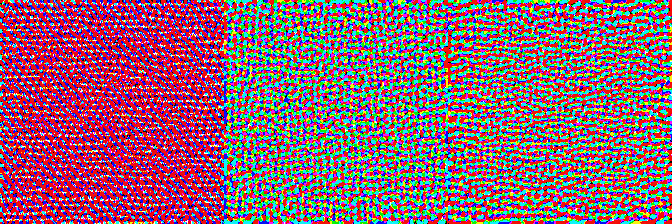

Registered hook on layer1.0.conv2


In [ ]:
N = 4
C1 = 2
C2 = 4

NEG = False
NEU = False
DREAM = False

N1 = 0
N2 = 1
L = conv_layers[N]
NEURON = 50

L1 = conv_layers[N1]
L2 = conv_layers[N2]

viz1 = featureviz(model, L, [C1], steps=128, )
viz2 = featureviz(model, L, [C2], steps=128, )
viz3 = featureviz(model, L, [C1, C2], )

display(to_pil(torch.cat([viz1, viz2, viz3 ], 3).detach())) # , viz4[-1]], 3)))

for h in hooks:
  h.handle.remove()

with torch.no_grad():
  loss_f = create_clip_loss(L)


In [ ]:
#@title Minimalistic Neural CA
ident = torch.tensor([[0.0,0.0,0.0],[0.0,1.0,0.0],[0.0,0.0,0.0]])
sobel_x = torch.tensor([[-1.0,0.0,1.0],[-2.0,0.0,2.0],[-1.0,0.0,1.0]])
lap = torch.tensor([[1.0,2.0,1.0],[2.0,-12,2.0],[1.0,2.0,1.0]])

def perchannel_conv(x, filters):
  '''filters: [filter_n, h, w]'''
  b, ch, h, w = x.shape
  y = x.reshape(b*ch, 1, h, w)
  # y = torch.nn.functional.pad(y, [1, 1, 1, 1], 'replicate')
  y = torch.nn.functional.pad(y, [1, 1, 1, 1], 'circular')
  y = torch.nn.functional.conv2d(y, filters[:,None])
  return y.reshape(b, -1, h, w)

def perception(x):
  filters = torch.stack([ident, sobel_x, sobel_x.T, lap] )
  return perchannel_conv(x, filters)


class VCA(torch.nn.Module):
  def __init__(self, chn=12, hidden_n=96):
    super().__init__()
    self.chn = chn
    self.hid = hidden_n

    self.w1 = torch.nn.Conv2d(chn*4, hidden_n, 1, groups=chn)

    self.w2 = torch.nn.Conv2d(hidden_n, chn, 1, bias=False, groups=1)
    self.w2.weight.data.zero_()


  def forward(self, x, update_rate=0.5):

    b, c, h, w, = x.shape

    y = perception(x)

    hidden = self.w1(y)

    hidden_mask = (torch.rand(b,c,h,w)+update_rate).floor()
    hidden_mask = hidden_mask.repeat_interleave(self.hid//self.chn, dim=1)  # per-input-channel random update
    hidden = hidden * hidden_mask

    y = self.w2(torch.relu(hidden))

    return x, y

  def seed(self, n, sz=128):
    return torch.zeros(n, self.chn, sz, sz)


def to_rgb(x):
  return x[...,:3,:,:]+0.5


def model_path(layer, channel):
  return MODEL_DIR + '/' + str(layer) + '_' + str(channel) + '.pt'

def get_model(layer, channel):
  return torch.load(model_path(layer, channel), weights_only=False)


In [ ]:
!mkdir -p models/featureviz

In [ ]:
#@title setup training
import copy

import random

MODEL_DIR = "models/featureviz"

# model
CHN = 12
NEW_MODEL = 0

# size
SZ = 112
TILE = 2
BS = 4

# TASK
CH = C1
DREAM=False

init_model_path = model_path("control_neuron_stable", "N4_4")
# init_model_path = model_path(0,0)


try:
  cleanup([ca, x, pca, pool])
except NameError:
  print("no var")


if not NEW_MODEL and os.path.exists(init_model_path):
  print("loading existing model", init_model_path)
  ca = torch.load(init_model_path, weights_only=False)
else:
  print("creating new model")
  ca = VCA(chn=CHN, hidden_n=CHN*8)
  torch.save(ca, model_path(0,0))


opt = torch.optim.Adam(ca.parameters(), 1e-3, capturable=True)
lr_sched = torch.optim.lr_scheduler.MultiStepLR(opt, [1000, 2000], 0.3)
loss_log = []
of_log = []


with torch.no_grad():
  pool = ca.seed(256, SZ)


param_n = sum(p.numel() for p in ca.parameters())
print('CA param count:', param_n)
print(CHN, 'channels', "x".join([str(p) for p in pool.shape[-2:]]), )
print('loss', L, CH)

# imshow(np.hstack(to_rgb(x.tile(1, 1, 4, 4)).permute([0, 2, 3, 1]).detach().cpu().numpy()))

no var
loading existing model models/featureviz/control_neuron_stable_N4_4.pt
CA param count: 1632
12 channels 112x112
loss layer1.0.conv2 2


In [ ]:
#@title training loop {vertical-output: true}

for i in range(5000):

  with torch.no_grad():
    batch_idx = np.random.choice(len(pool), BS, replace=False)
    x = pool[batch_idx]

    if i%4 == 0:
      x[:1, ...] = ca.seed(1, SZ)

  step_n = np.random.randint(32, 96)

  for _ in range(step_n):
    x, dx = ca(x)
    x = x + dx

  overflow_loss = (x-x.clamp(-1.0, 1.0)).abs().sum()

  chs = None if DREAM else [CH for _ in range(BS)]
  loss = loss_f(to_rgb(x.tile(1, 1, TILE, TILE)), channels=chs)

  total_loss = loss + overflow_loss

  with torch.no_grad():
    total_loss.backward()
    for p in ca.parameters():
      p.grad /= (p.grad.norm()+1e-8)   # normalize gradients

    opt.step()
    opt.zero_grad()
    lr_sched.step()
    pool[batch_idx] = x                # update pool

    loss_log.append(total_loss.item())
    of_log.append(overflow_loss.item())

    if i%50==0:

      pl.plot(loss_log, '.', alpha=0.1)
      pl.plot(of_log, '+', alpha=.1)

      pl.yscale('log')
      pl.ylim(np.min(loss_log), loss_log[0])
      pl.tight_layout()
      imshow(grab_plot(), id='log')
      imgs = to_rgb(x.tile(1, 1, TILE, TILE)).permute([0,2,3,1]).cpu()
      imshow(np.hstack(imgs), id='batch')

      display(Markdown(f'''
        step_n: {len(loss_log)}
        loss: {loss.item()}
        overflow: {overflow_loss.item()}
        batch: {batch_idx}


        lr: {lr_sched.get_last_lr()[0]}'''), display_id='stats')

      clear_output(wait=True)


KeyboardInterrupt: 

In [ ]:
#@title NCA video {vertical-output: true}
# imshow(np.hstack(to_rgb(x.tile(1, 1, TILE, TILE)).permute([0, 2, 3, 1]).detach().cpu().numpy()))
with VideoWriter() as vid, torch.no_grad():
  x1 = ca.seed(1, 256)
  sz = x1.shape[-1]

  for k in tnrange(300, leave=False):
  # for k in tnrange(900, leave=False):
    step_n = min(2**(k//30), 8)
    for i in range(step_n):
      x1, dx1 = ca(x1)
      x1 = x1 + dx1
    img1 = (to_rgb(x1[0])).permute(1, 2, 0).cpu().numpy()
    # img4 = (to_rgb(x30[0, 2:, ...])).permute(1,2,0).cpu().numpy()

    # начало что-то красивое
    vid.add(zoom(np.hstack([img1]), 2)) # img4, img5]) , 2))


  for k in tnrange(300, leave=False):



  0%|          | 0/300 [00:00<?, ?it/s]

In [ ]:
N, 'dream' if DREAM else CH

(4, 2)

In [ ]:
torch.save(ca, model_path("control_neuron_stable", "N4_2"))

In [ ]:
with torch.no_grad():
  ca1 = torch.load('models/featureviz/control_neuron_stable_N4_2.pt', weights_only=False)
  ca2 = torch.load('models/featureviz/control_neuron_stable_N4_4.pt', weights_only=False)

In [ ]:
#@title NCA video {vertical-output: true}
SZ1 = 256
with VideoWriter() as vid, torch.no_grad():
  x1 = ca.seed(1, SZ1)
  x2 = ca.seed(1, SZ1)
  x3 = ca.seed(1, SZ1)
  sz = x1.shape[-1]
  print(x1.shape)

  for k in tnrange(300, leave=False):
    step_n = min(2**(k//30), 8)
    for i in range(step_n):
      x1, dx1 = ca1(x1)
      x1 = x1 + dx1

      x2, dx2 = ca2(x2)
      x2 = x2 + dx2

      x31, dx31 = ca1(x3)
      x32, dx32 = ca2(x3)
      x3 = x3 + (dx31 + dx32)

    img1 = (to_rgb(x1[0])).permute(1, 2, 0).cpu().numpy()
    img2 = (to_rgb(x2[0])).permute(1, 2, 0).cpu().numpy()
    img3 = (to_rgb(x3[0])).permute(1, 2, 0).cpu().numpy()

    vid.add(zoom(np.hstack([img1, img2, img3,]), 2))


  for k in tnrange(300, leave=False):



torch.Size([1, 12, 256, 256])


  0%|          | 0/300 [00:00<?, ?it/s]

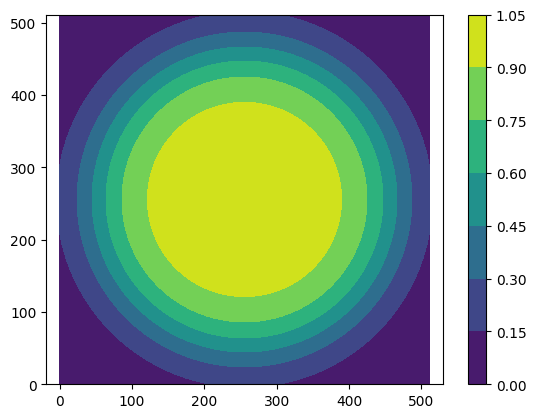

In [ ]:
W = 512
with torch.no_grad():
  r = torch.linspace(-1, 1., W)**2
  r = (r+r[:,None]).sqrt()
  mask = ((.8-r)*8.0).sigmoid()
  pl.contourf(mask.cpu())
  pl.colorbar()
  pl.axis('equal')

In [ ]:

with VideoWriter() as vid, torch.no_grad():
  x = torch.zeros([1, ca1.chn, W, W])

  for k in range(300):
    x1, dx1 = ca1(x)
    x2, dx2 = ca2(x)
    x = x + (dx2 + (dx1-dx2)*mask) /2.

  for i in tnrange(300):
    for k in range(8):
      x1, dx1 = ca1(x)
      x2, dx2 = ca2(x)
      x = x + (dx2 + (dx1-dx2)*mask) /2.
    img = to_rgb(x[0]).permute(1, 2, 0).cpu()
    vid.add(zoom(img, 1))



  for i in tnrange(300):



  0%|          | 0/300 [00:00<?, ?it/s]